# Random walking

In [1]:
import scvelo as scv
import cellrank as cr

In [2]:
adata = scv.read("../data/processed/06_adata_velo.h5ad")

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


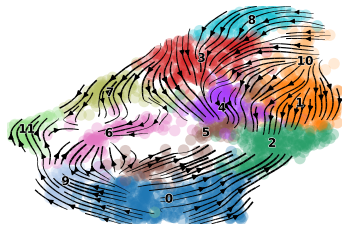

In [3]:
scv.pl.velocity_embedding_stream(
    adata, basis="umap", color=['seurat_clusters'], legend_fontsize=12, title="", smooth=0.8, min_mass=4
)

In [4]:
adata.obs['tag'] = adata.obs.seurat_clusters.astype(str) + "-" +adata.obs.HTO_classification.astype(str)
adata.obs['tag'] = adata.obs['tag'].astype('category')

## Random walk

In [5]:
k = cr.tl.transition_matrix(
    adata, weight_connectivities=0.2, softmax_scale=4, show_progress_bar=False
)

/projects/dan1/people/fdb589/envs/cellrank-1.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  


In [6]:
adata.obs.tag.cat.categories

Index(['0-A0259', '0-A0260', '0-A0262', '0-A0263', '1-A0259', '1-A0260',
       '1-A0262', '1-A0263', '10-A0259', '10-A0260', '10-A0262', '10-A0263',
       '11-A0259', '11-A0260', '11-A0262', '11-A0263', '2-A0259', '2-A0260',
       '2-A0262', '2-A0263', '3-A0259', '3-A0260', '3-A0262', '3-A0263',
       '4-A0259', '4-A0263', '5-A0259', '5-A0260', '5-A0262', '5-A0263',
       '6-A0259', '6-A0260', '6-A0262', '6-A0263', '7-A0259', '7-A0260',
       '7-A0262', '7-A0263', '8-A0259', '8-A0260', '8-A0262', '8-A0263',
       '9-A0260', '9-A0262', '9-A0263'],
      dtype='object')

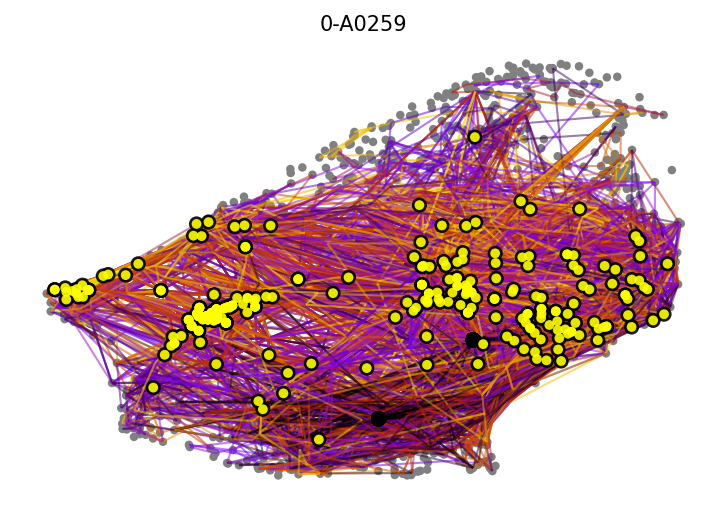

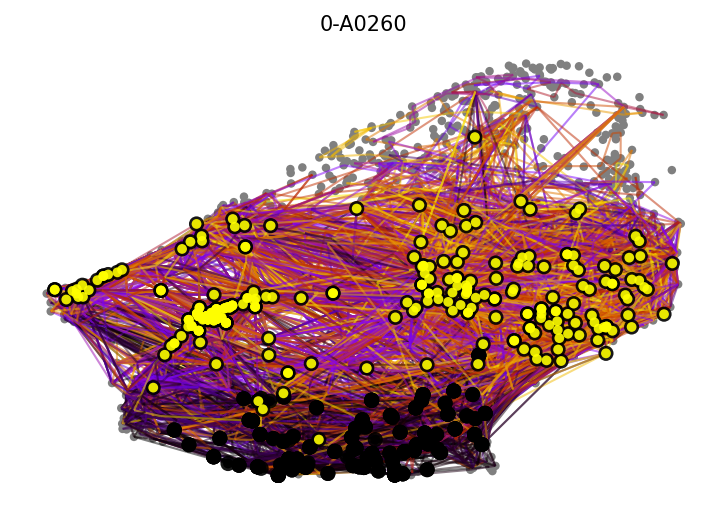

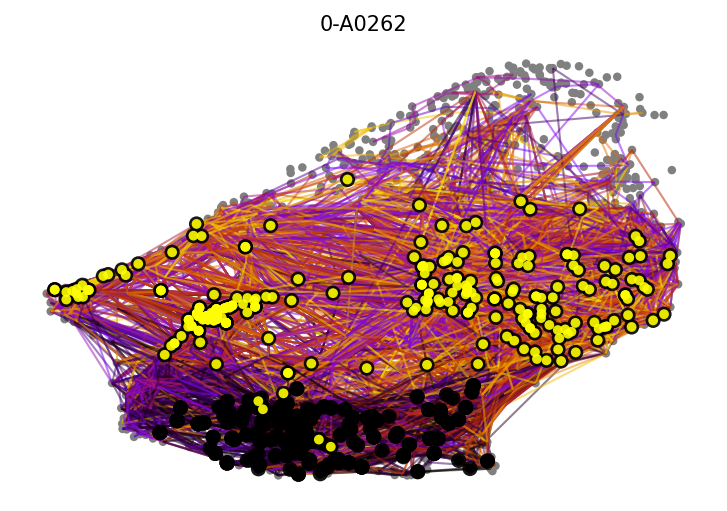

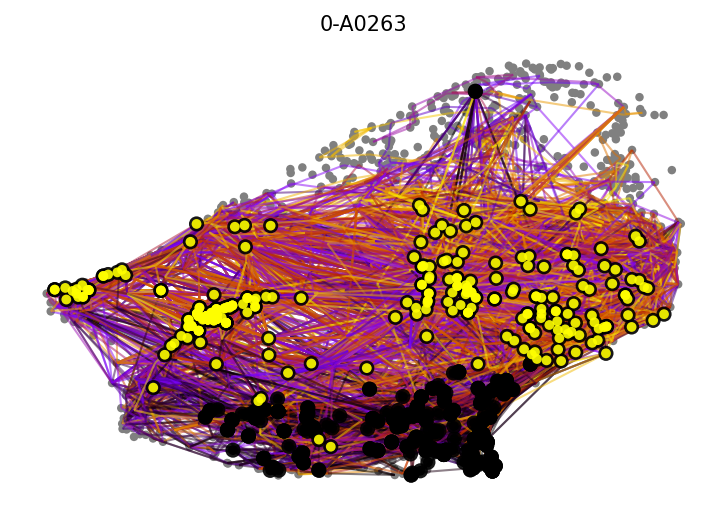

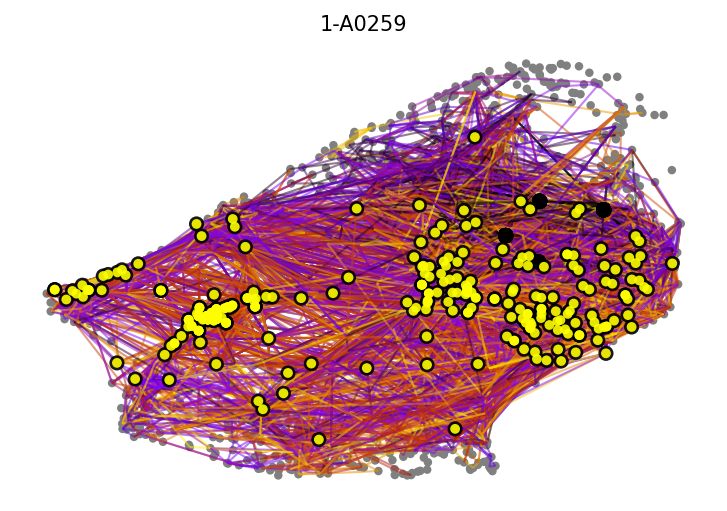

...

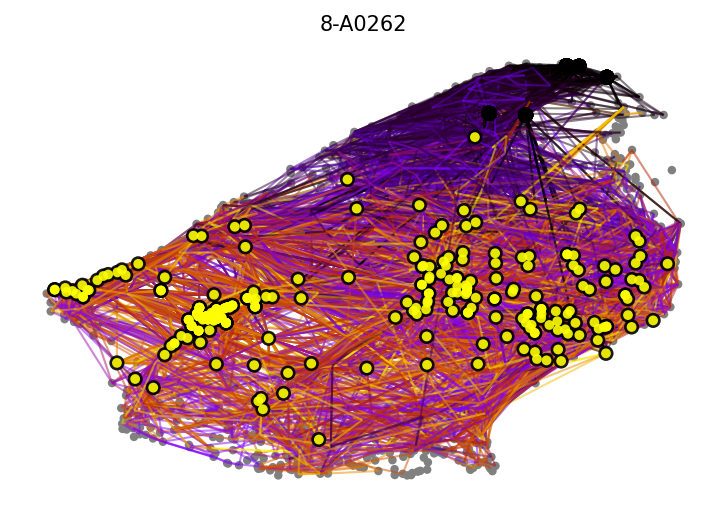

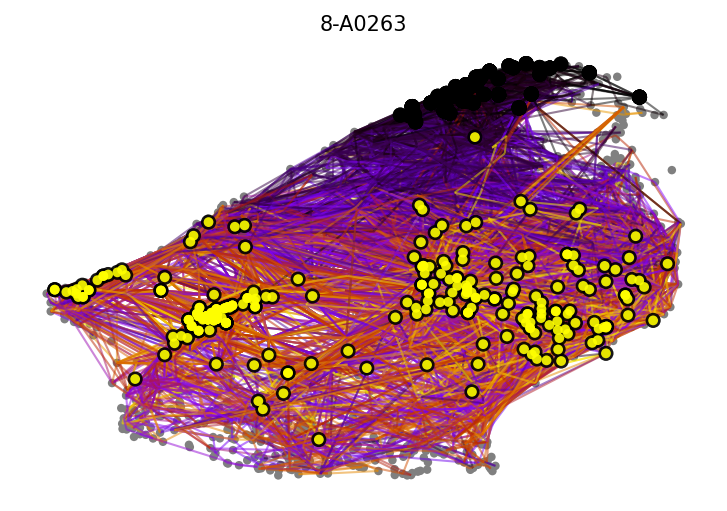

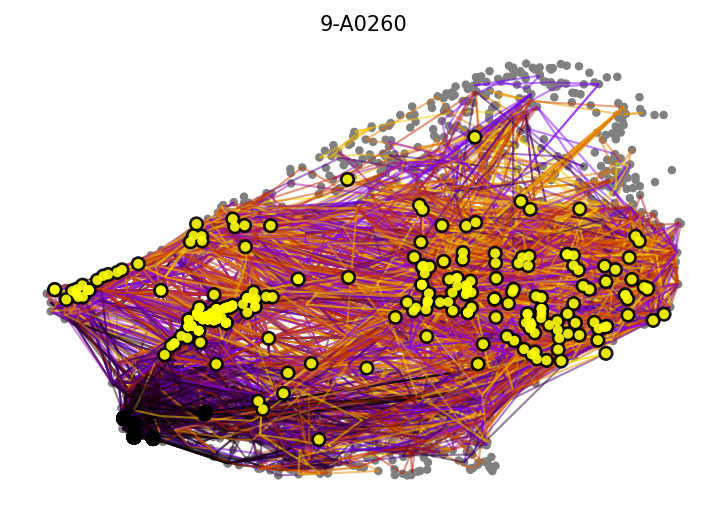

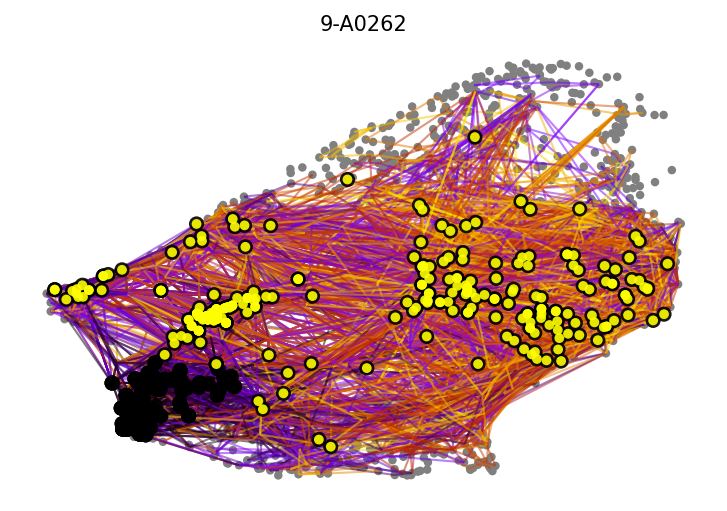

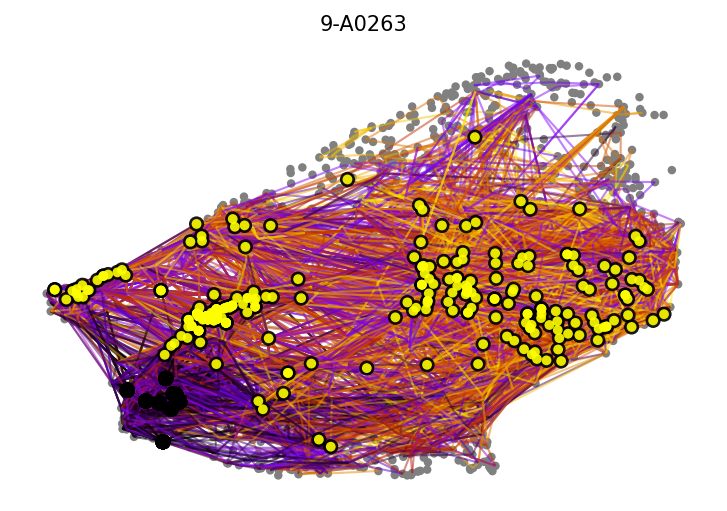

In [7]:
for tag in adata.obs.tag.cat.categories:
    k.plot_random_walks(
        n_sims=300, 
        start_ixs={"tag": tag},
        max_iter=200,
        show_progress_bar=False,
        linealpha=0.5,
        dpi=150,
        seed=42,
        title=tag,
        n_jobs=10,
    )

In [9]:
!jupyter nbconvert --to html 07_random_walking.ipynb --output-dir="../reports"

[NbConvertApp] Converting notebook 07_random_walking.ipynb to html
[NbConvertApp] Writing 27772301 bytes to ../reports/07_random_walking.html
